## Imports and Version check

In [25]:
import tensorflow as tf
print(tf.__version__)
!nvidia-smi

2.5.0
Sun Jul 25 11:33:30 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-

## Setting up necessary files

In [26]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 59127, done.
remote: Counting objects: 100% (583/583), done.
remote: Compressing objects: 100% (263/263), done.
remote: Total 59127 (delta 372), reused 511 (delta 313), pack-reused 58544
Receiving objects: 100% (59127/59127), 573.56 MiB | 18.11 MiB/s, done.
Resolving deltas: 100% (41001/41001), done.
Checking out files: 100% (2579/2579), done.


In [27]:
cd /content/models/research

/content/models/research


In [28]:
!protoc object_detection/protos/*.proto --python_out=.

In [29]:
!git clone https://github.com/cocodataset/cocoapi.git

fatal: destination path 'cocoapi' already exists and is not an empty directory.


In [30]:
  cd cocoapi/PythonAPI

/content/models/research/cocoapi/PythonAPI


In [31]:
!make

python setup.py build_ext --inplace
running build_ext
skipping 'pycocotools/_mask.c' Cython extension (up-to-date)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/pycocotools
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fdebug-prefix-map=/build/python3.7-LSlbJj/python3.7-3.7.11=. -fstack-protector-strong -Wformat -Werror=format-security -g -fdebug-prefix-map=/build/python3.7-LSlbJj/python3.7-3.7.11=. -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/lib/python3.7/dist-packages/numpy/core/include -I../common -I/usr/include/python3.7m -c ../common/maskApi.c -o build/temp.linux-x86_64-3.7/../common/maskApi.o -Wno-cpp -Wno-unused-function -std=c99
../common/maskApi.c: In function ‘rleDecode’:
../common/maskApi.c:46:7: warning: this ‘for’ clause does not guard... [-Wmisleading-ind

In [32]:
cp -r pycocotools /content/models/research

In [33]:
cd ../../

/content/models/research


In [34]:
cp object_detection/packages/tf2/setup.py .

In [35]:
!python -m pip install .

Processing /content/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1660323 sha256=990bfaa1ce520d6eb67d5eeb2720d1f607de78dac2e4f1e0360562b7ee60acae
  Stored in directory: /tmp/pip-ephem-wheel-cache-7yd0rg2n/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


In [36]:
!python object_detection/builders/model_builder_tf2_test.py

2021-07-25 11:34:52.182810: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.11: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2021-07-25 11:34:54.013555: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-07-25 11:34:54.048457: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-07-25 11:34:54.049332: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-07-25 11:34:54.049389: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfull

- Downloading the pre-trained model. So only download once

In [37]:
cd /content/drive/MyDrive/ANPR/training/pre-trained-models

/content/drive/MyDrive/ANPR/training/pre-trained-models


In [38]:
# !wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

--2021-07-25 11:35:19--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.9.208, 2607:f8b0:4004:806::2010
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.9.208|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz.1’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M  68.5MB/s    in 3.5s    

2021-07-25 11:35:23 (67.6 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz.1’ saved [244817203/244817203]



In [17]:
!tar -xvf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/checkpoint
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/pipeline.config
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model/saved_model.pb
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model/assets/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model/variables/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [24]:
cp ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/pipeline.config ../my-models/my_ssd_resnet50_v1_fpn_640x6400/pipeline.config

Now make the required changes in 

my_model/my_ssd_mobilenet_v2_320x320/pipeline.config

This is an demo code, make changes according to your dataset
- 3 ⇒ num_classes: 2
- 131 ⇒ batch_size: 8
- 152 ⇒ total_steps: 2000 and also at  162 ⇒ num_steps: 2000 , These are basically the number of epochs to train.
- 161 ⇒ fine_tune_checkpoint: "pre-trained-models/ssd_resnet101_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0"
- 167 ⇒ fine_tune_checkpoint_type: "detection"
- 168 ⇒ use_bfloat16: false
- 172 ⇒ label_map_path: "annotations/label_map.pbtxt"
- 174 ⇒ input_path: "annotations/train.record"
- 182 ⇒ label_map_path: "annotations/label_map.pbtxt"
- 186 ⇒ input_path: "annotations/test.record"

- Creating the TFrecords from XML annotations

In [41]:
cd ../scripts

/content/drive/My Drive/ANPR/training/scripts


In [42]:
# Create train data:
!python generate_tfrecord.py -x ../images/train -l ../annotations/label_map.pbtxt -o ../annotations/train.record

# Create test data:
!python generate_tfrecord.py -x ../images/test -l ../annotations/label_map.pbtxt -o ../annotations/test.record

Successfully created the TFRecord file: ../annotations/train.record
Successfully created the TFRecord file: ../annotations/test.record


# Training

In [43]:
cd /content/drive/MyDrive/ANPR/training

/content/drive/MyDrive/ANPR/training


In [44]:
cp ../../../../models/research/object_detection/model_main_tf2.py model_main_tf2.py 

In [ ]:
# /content/drive/MyDrive/ANPR/training/my-models/my_ssd_resnet50_v1_fpn_640x6400

In [45]:
!python model_main_tf2.py --model_dir=my-models/my_ssd_resnet50_v1_fpn_640x6400 --pipeline_config_path=my-models/my_ssd_resnet50_v1_fpn_640x6400/pipeline.config

2021-07-25 11:50:44.868726: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-25 11:50:47.078361: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-07-25 11:50:47.111560: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-07-25 11:50:47.112144: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-07-25 11:50:47.112189: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-25 11:50:47.117862: I tensorflow/stream_executor/platform/default

- ## Exporting to .pb

In [46]:
cp ../../../../models/research/object_detection/exporter_main_v2.py exporter_main_v2.py

In [47]:
!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path "my-models/my_ssd_resnet50_v1_fpn_640x6400/pipeline.config" --trained_checkpoint_dir "my-models/my_ssd_resnet50_v1_fpn_640x6400" --output_directory "exported-models/my_ssd_resnet50_v1_fpn_640x6400"

2021-07-25 13:20:48.111467: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-25 13:20:51.238613: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-07-25 13:20:51.276404: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-07-25 13:20:51.277074: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-07-25 13:20:51.277122: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-25 13:20:51.292155: I tensorflow/stream_executor/platform/default

!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path "my_model/my_ssd_mobilenet_v2_320x320/pipeline.config" --trained_checkpoint_dir "my_model/my_ssd_mobilenet_v2_320x320" --output_directory "exported-models/my_ssd_mobilenet_v2_320x320"

# Visualization usnig Tensorboard 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "/content/drive/MyDrive/Vehicle Detection/training/my_model/my_ssd_mobilenet_v2_320x320/"

Output hidden; open in https://colab.research.google.com to view.

# Results

- Imports

In [48]:
import time
import os
import numpy as np
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from tensorflow.keras.preprocessing.image import img_to_array,load_img
# optional
from google.colab.patches import cv2_imshow
# from PIL import Image
# import matplotlib.pyplot as plt
# %matplotlib inline

# Enable GPU dynamic memory allocation (do not use this for colab)
# gpus = tf.config.experimental.list_physical_devices('GPU')
# for gpu in gpus:
#     tf.config.experimental.set_memory_growth(gpu, True)


- Loading the model

In [49]:
PATH_TO_SAVED_MODEL = "exported-models/my_ssd_resnet50_v1_fpn_640x6400/saved_model"
PATH_TO_LABELS = "annotations/label_map.pbtxt"

print('Loading Model...')
start_time = time.time()
loaded_model = tf.saved_model.load(PATH_TO_SAVED_MODEL)

# Loading the pbtxt
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

print('Done! Took {} seconds'.format(time.time() - start_time))

Loading Model...
Done! Took 13.133241653442383 seconds


- Checking the signature of the models i.e output shapes, datatypes and inputs

In [50]:
print(loaded_model.signatures['serving_default'].inputs[0])
print(loaded_model.signatures['serving_default'].output_dtypes)
print(loaded_model.signatures['serving_default'].output_shapes)
# Here the input is expected in uint8 dtype, but our is in float32. So we need to convert that below.

Tensor("input_tensor:0", shape=(1, None, None, 3), dtype=uint8)
{'detection_boxes': tf.float32, 'detection_classes': tf.float32, 'detection_scores': tf.float32, 'detection_multiclass_scores': tf.float32, 'num_detections': tf.float32, 'raw_detection_boxes': tf.float32, 'detection_anchor_indices': tf.float32, 'raw_detection_scores': tf.float32}
{'detection_boxes': TensorShape([1, 100, 4]), 'detection_classes': TensorShape([1, 100]), 'detection_scores': TensorShape([1, 100]), 'detection_multiclass_scores': TensorShape([1, 100, 2]), 'num_detections': TensorShape([1]), 'raw_detection_boxes': TensorShape([1, 51150, 4]), 'detection_anchor_indices': TensorShape([1, 100]), 'raw_detection_scores': TensorShape([1, 51150, 2])}


- ### Making Single Prediction

In [52]:
# Image to array
test_image_o = load_img('images/test/Cars336.png')
test_image_array = img_to_array(test_image_o)

# The model expects a batch of images, so add an axis
test_image_array_ex = np.expand_dims(test_image_array,axis=0)

# Image to Tensor
test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
# test_image_tensor = test_image_tensor[tf.newaxis,...]
test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.

# Predictions
prediction = loaded_model(test_image_tensor)

- Preprocessing prediction

In [53]:
# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.\

num_bboxes = int(prediction.pop('num_detections'))
prediction = {key: value[0, :num_bboxes].numpy()
               for key, value in prediction.items()}
prediction['num_detections'] = num_bboxes

# detection_classes should be ints.
prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)

- Drawing the bounding boxes

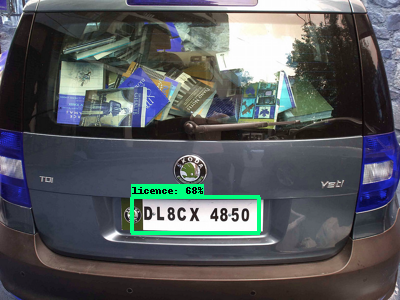

In [54]:
image_with_detections = test_image_array.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_with_detections,
      prediction['detection_boxes'],
      prediction['detection_classes'],
      prediction['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=5,
      min_score_thresh=0.4,
      agnostic_mode=False)

# For colab
from google.colab.patches import cv2_imshow
cv2_imshow(image_with_detections) 

# For local machine
# from PIL import Image
# import matplotlib.pyplot as plt
# %matplotlib inline
# Image.fromarray(image_with_detections, 'RGB')

- ### Making group predicition



In [55]:
NO_OF_PREDICTIONS = 25
TEST_IMAGE_PATH = 'images/test'
TEST_IMAGE_EXTENSION = '.png'

input_images = [img for img in os.listdir(TEST_IMAGE_PATH) if img.lower().endswith(TEST_IMAGE_EXTENSION)][:NO_OF_PREDICTIONS]
for img in input_images:
  img_path = os.path.join(TEST_IMAGE_PATH,img)
  test_image_o = load_img(img_path)
  test_image_array = img_to_array(test_image_o)
  test_image_array_ex = np.expand_dims(test_image_array,axis=0)

  test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
  test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.

  prediction = loaded_model(test_image_tensor)
  # prediction preprocessing
  num_bboxes = int(prediction.pop('num_detections'))
  prediction = {key: value[0, :num_bboxes].numpy()
                 for key, value in prediction.items()}
  prediction['num_detections'] = num_bboxes
  # detection_classes should be ints.
  prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)

  image_with_detections = test_image_array.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_with_detections,
        prediction['detection_boxes'],
        prediction['detection_classes'],
        prediction['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=5,
        min_score_thresh=0.4,
        agnostic_mode=False)

  # For colab
  cv2_imshow(image_with_detections) 

  # For local machine
  # from PIL import Image
  # import matplotlib.pyplot as plt
  # %matplotlib inline
  # Image.fromarray(image_with_detections, 'RGB')

Output hidden; open in https://colab.research.google.com to view.